<a href="https://colab.research.google.com/github/Yomunozs/Aprendizaje_Maquina/blob/main/Mario/Mario%2010K%20/sm_teach.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
#!pip install gym==0.17.2
#!pip install gym-super-mario-bros==7.3.0
#!pip install nes-py==8.1.8
#!pip install tf-agents==0.5.0
#!pip install tensorflow==2.2.0

#librerias necesarias
!sudo apt-get update
!sudo apt-get install -y xvfb ffmpeg freeglut3-dev
!pip install 'imageio==2.4.0'
!pip install pyvirtualdisplay
!pip install tf-agents[reverb]
!pip install pyglet
!pip install swig
!pip install gym[atari,box2d,accept-rom-license]  #install gym and virtual display
!pip install gym-super-mario-bros

Get:1 https://packages.cloud.google.com/apt gcsfuse-focal InRelease [1227 B]
Get:2 https://packages.cloud.google.com/apt cloud-sdk InRelease [1618 B]       
Get:3 https://packages.cloud.google.com/apt gcsfuse-focal/main amd64 Packages [27.8 kB]
Hit:4 http://archive.ubuntu.com/ubuntu focal InRelease                         
Get:5 http://security.ubuntu.com/ubuntu focal-security InRelease [128 kB]
Get:6 https://packages.cloud.google.com/apt cloud-sdk/main all Packages [1534 kB]
Get:7 http://archive.ubuntu.com/ubuntu focal-updates InRelease [128 kB]        
Get:8 https://packages.cloud.google.com/apt cloud-sdk/main amd64 Packages [3285 kB]
Get:9 http://security.ubuntu.com/ubuntu focal-security/main amd64 Packages [4024 kB]
Hit:10 http://archive.ubuntu.com/ubuntu focal-backports InRelease
Get:11 http://archive.ubuntu.com/ubuntu focal-updates/universe amd64 Packages [1560 kB]
Get:12 http://archive.ubuntu.com/ubuntu focal-updates/main amd64 Packages [4487 kB]
Get:13 http://security.ubuntu.co

In [ ]:
from __future__ import absolute_import, division, print_function

import base64
import imageio
import IPython
import matplotlib
import matplotlib.pyplot as plt
import numpy as np
import PIL.Image
import pyvirtualdisplay
import reverb

import tensorflow as tf

from tf_agents.environments import suite_gym, tf_py_environment
from tf_agents.environments.wrappers import ActionRepeat
from tf_agents.networks.q_network import QNetwork
from tf_agents.agents.dqn.dqn_agent import DqnAgent
from tf_agents.utils import common
from tf_agents.replay_buffers import TFUniformReplayBuffer
from tf_agents.trajectories import trajectory
from tf_agents.policies import random_tf_policy
from tf_agents.drivers.dynamic_step_driver import DynamicStepDriver


from tf_agents.environments import gym_wrapper
from tf_agents.environments import tf_py_environment

import gym
from nes_py.wrappers import JoypadSpace
import gym_super_mario_bros
from gym_super_mario_bros.actions import SIMPLE_MOVEMENT

# To get smooth animations
import matplotlib.animation as animation
matplotlib.rc('animation', html='jshtml')

2024-09-26 15:49:20.263715: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-09-26 15:49:20.263786: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-09-26 15:49:20.265604: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


/opt/conda/lib/python3.10/site-packages/gym/envs/registration.py:505: UserWarning: WARN: The environment SuperMarioBros-v1 is out of date. You should consider upgrading to version `v3` with the environment ID `SuperMarioBros-v3`.
  logger.warn(


['NOOP', 'right', 'right A', 'right B', 'right A B', 'A', 'left']


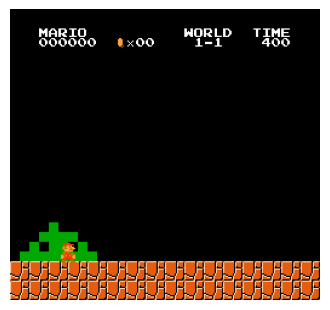

NameError: name 'eval_env' is not defined

In [ ]:
env = gym_super_mario_bros.make('SuperMarioBros-v1')
env = JoypadSpace(env, SIMPLE_MOVEMENT)
print(env.get_action_meanings())
state = env.reset()
env.step(env._action_space.sample())
img = env.render(mode="rgb_array")
plt.figure(figsize=(4, 6))
plt.imshow(img)
plt.axis("off")
plt.show()
# Create and wrap the environment
def create_environment():
    # Load the Super Mario Bros environment
    env = gym_super_mario_bros.make('SuperMarioBros-v1')
    # Simplify the action space
    env = JoypadSpace(env, SIMPLE_MOVEMENT)
    # Apply preprocessing wrappers
    env = gym.wrappers.GrayScaleObservation(env, keep_dim=True)
    env = gym.wrappers.ResizeObservation(env, 84)
    env = gym.wrappers.FrameStack(env, 4)
    env = gym_wrapper.GymWrapper(env)
    return env
# Configurar una pantalla virtual para renderizar entornos de OpenAI Gym
display = pyvirtualdisplay.Display(visible=0, size=(1400, 900)).start()  # Se inicia la pantalla virtual

# Funciones de visualización proporcionadas
def update_scene(num, frames, patch):  # Se define la función para actualizar la escena
    patch.set_data(frames[num])  # Se actualizan los datos del frame actual
    return patch  # Se devuelve el parche actualizado

def plot_animation(frames, repeat=False, interval=40):  # Se define la función para crear la animación
    fig = plt.figure()  # Se crea una nueva figura
    patch = plt.imshow(frames[0])  # Se muestra el primer frame
    plt.axis('off')  # Se ocultan los ejes
    anim = animation.FuncAnimation(  # Se crea la animación
        fig, update_scene, fargs=(frames, patch),
        frames=len(frames), repeat=repeat, interval=interval)
    plt.close()  # Se cierra la figura para no mostrarla dos veces
    return anim  # Se devuelve la animación creada
def random_policy():
    return np.random.choice(len(SIMPLE_MOVEMENT))
# Recoger frames para la visualización
def run_and_visualize(env):
    frames = []
    time_step = env.reset()
    #policy_state = agent.policy.get_initial_state(env.batch_size)

    for i in range(15000):
        action_step = random_policy()
        #policy_state = action_step.state
        time_step = env.step(action_step)

        # Obtener el frame y asegurarse de que es un array numpy
        frame = np.squeeze(env.render())

        frames.append(frame)
        i += 1

    print(f"Total frames collected: {len(frames)}")
    return frames

# Ejecutar el agente y recoger marcos
frames = run_and_visualize( eval_env)  # Se ejecuta la función para recoger marcos

# Crear y mostrar la animación
anim = plot_animation(frames)  # Se crea la animación a partir de los marcos

# Mostrar la animación en Jupyter Notebook
from IPython.display import HTML  # Se importa la librería necesaria
HTML(anim.to_jshtml())  # Se convierte la animación a formato HTML y se muestra


In [ ]:
# Instantiate training and evaluation environments
train_py_env = create_environment()
eval_py_env = create_environment()
train_env = tf_py_environment.TFPyEnvironment(train_py_env)
eval_env = tf_py_environment.TFPyEnvironment(eval_py_env)

/opt/conda/lib/python3.10/site-packages/gym/envs/registration.py:505: UserWarning: WARN: The environment SuperMarioBros-v1 is out of date. You should consider upgrading to version `v3` with the environment ID `SuperMarioBros-v3`.
  logger.warn(


In [ ]:
# Convert to TensorFlow Agents environments
train_env = tf_py_environment.TFPyEnvironment(train_py_env)
eval_env = tf_py_environment.TFPyEnvironment(eval_py_env)

In [ ]:
# Define the Q-network
preprocessing_layer = tf.keras.layers.Lambda(lambda x: tf.cast(x, np.float32) / 255.)
conv_layer_params = [
    (32, (8, 8), 4),
    (64, (4, 4), 2),
    (64, (3, 3), 1),
]
fc_layer_params = [512]

q_net = QNetwork(
    input_tensor_spec=train_env.observation_spec(),
    action_spec=train_env.action_spec(),
    preprocessing_layers=preprocessing_layer,
    conv_layer_params=conv_layer_params,
    fc_layer_params=fc_layer_params
)

# Create the DQN agent
optimizer = tf.compat.v1.train.RMSPropOptimizer(
    learning_rate=2.5e-4,
    decay=0.95,
    momentum=0.0,
    epsilon=0.01,
    centered=True
)
train_step_counter = tf.Variable(0)

agent = DqnAgent(
    time_step_spec=train_env.time_step_spec(),
    action_spec=train_env.action_spec(),
    q_network=q_net,
    optimizer=optimizer,
    td_errors_loss_fn=common.element_wise_squared_loss,
    train_step_counter=train_step_counter,
    gamma=0.99,
    epsilon_greedy=0.1,
    target_update_period=10000
)


In [ ]:
agent.initialize()

# Create the replay buffer
replay_buffer = TFUniformReplayBuffer(
    data_spec=agent.collect_data_spec,
    batch_size=train_env.batch_size,
    max_length=100000
)

In [ ]:
# Function to collect experience
def collect_step(environment, policy, buffer):
    time_step = environment.current_time_step()
    action_step = policy.action(time_step)
    next_time_step = environment.step(action_step.action)
    traj = trajectory.from_transition(time_step, action_step, next_time_step)
    buffer.add_batch(traj)

# Collect initial data with a random policy
random_policy = random_tf_policy.RandomTFPolicy(train_env.time_step_spec(), train_env.action_spec())
initial_collect_steps = 1000
for _ in range(initial_collect_steps):
    collect_step(train_env, random_policy, replay_buffer)

# Prepare the dataset
dataset = replay_buffer.as_dataset(
    num_parallel_calls=3,
    sample_batch_size=32,
    num_steps=2
).prefetch(3)
iterator = iter(dataset)



In [ ]:
import time

Iteration: 0, Loss: 2.018526792526245
Tiempo transcurrido para 300 iteraciones: 0.55 segundos


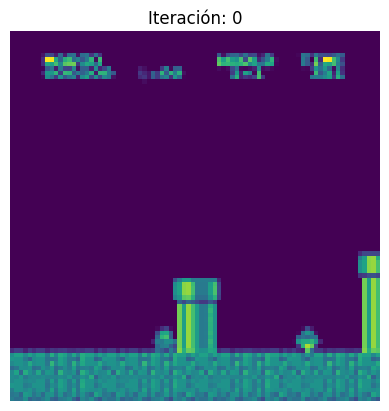

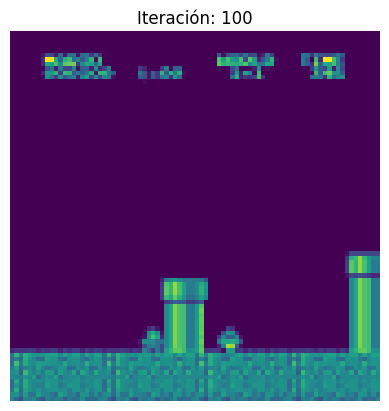

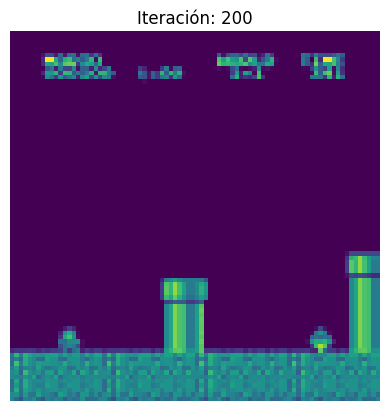

Iteration: 300, Loss: 0.4321436285972595
Tiempo transcurrido para 300 iteraciones: 88.47 segundos


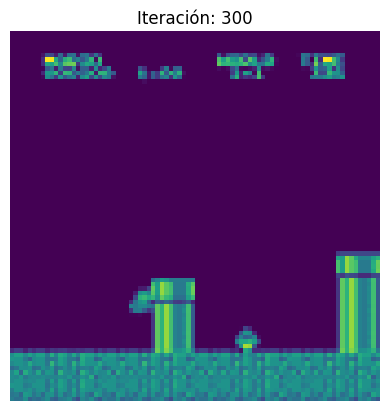

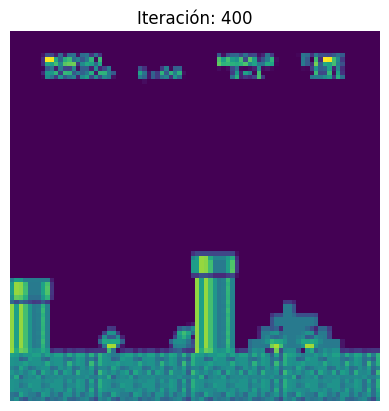

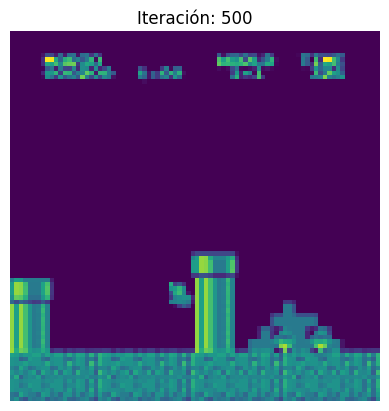

Iteration: 600, Loss: 0.47117936611175537
Tiempo transcurrido para 300 iteraciones: 177.41 segundos


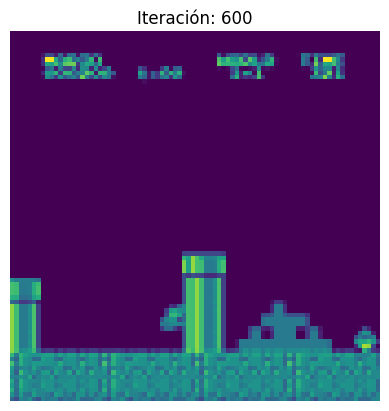

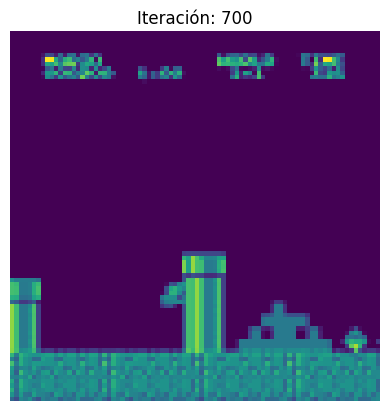

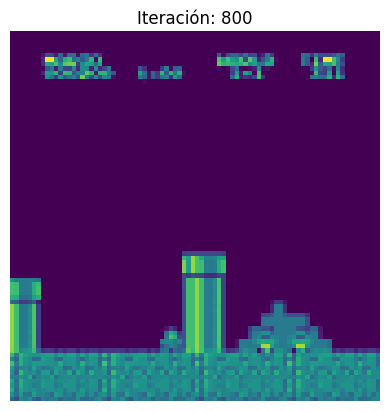

Iteration: 900, Loss: 0.282487690448761
Tiempo transcurrido para 300 iteraciones: 263.91 segundos


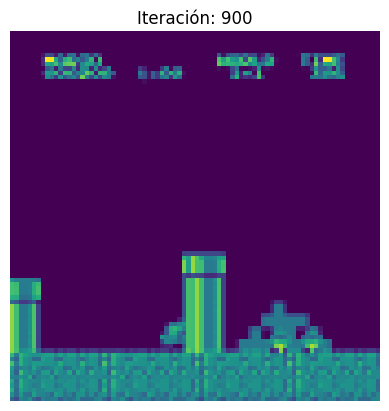

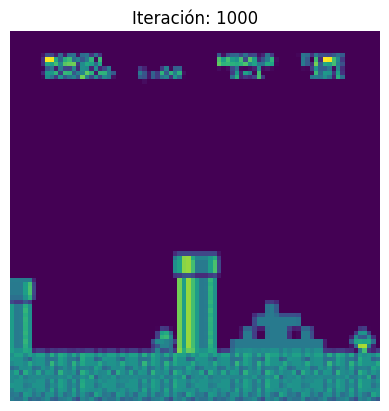

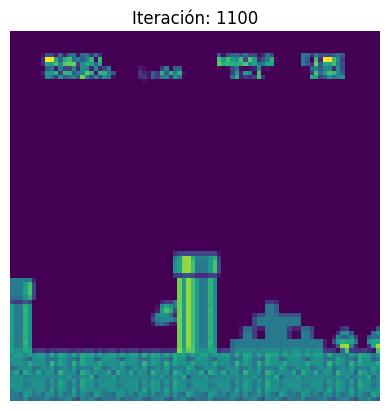

Iteration: 1200, Loss: 0.1800464391708374
Tiempo transcurrido para 300 iteraciones: 352.20 segundos


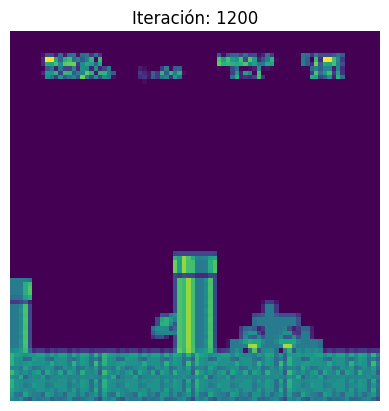

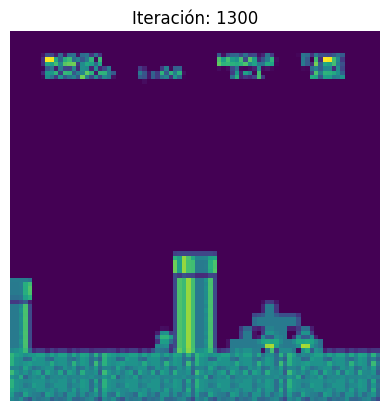

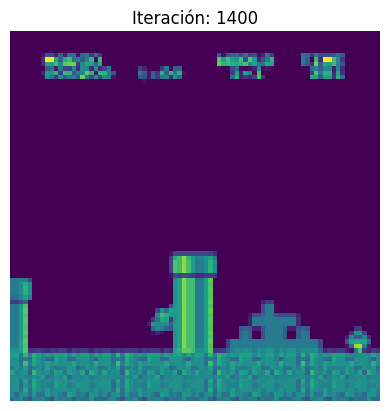

Iteration: 1500, Loss: 0.3253135681152344
Tiempo transcurrido para 300 iteraciones: 438.89 segundos


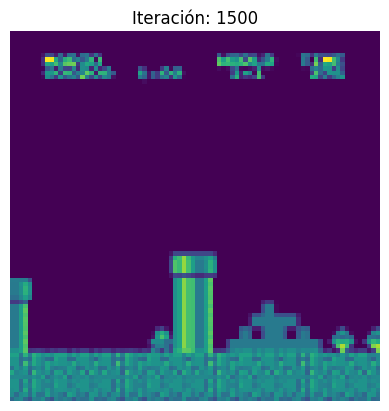

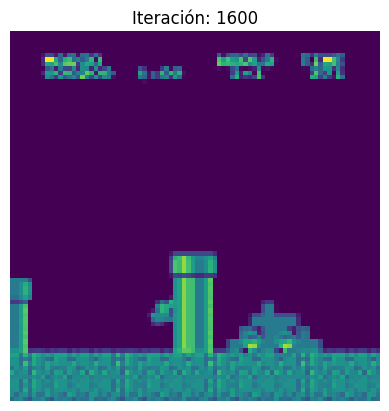

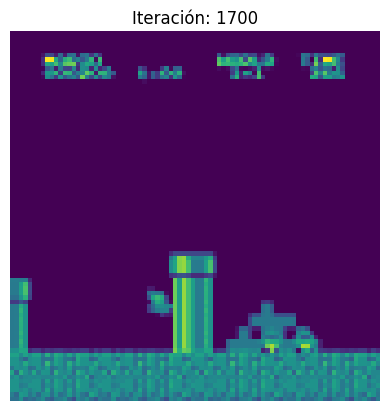

Iteration: 1800, Loss: 0.18850703537464142
Tiempo transcurrido para 300 iteraciones: 530.60 segundos


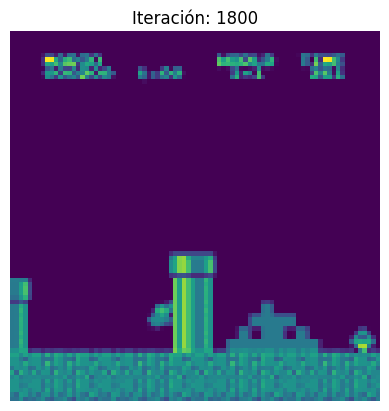

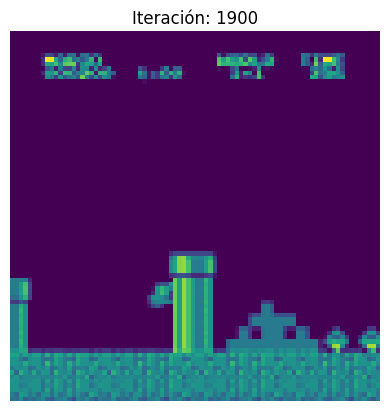

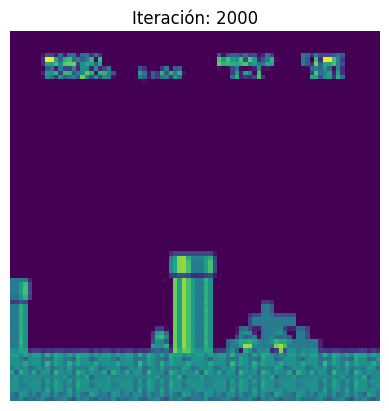

Iteration: 2100, Loss: 0.12734143435955048
Tiempo transcurrido para 300 iteraciones: 621.79 segundos


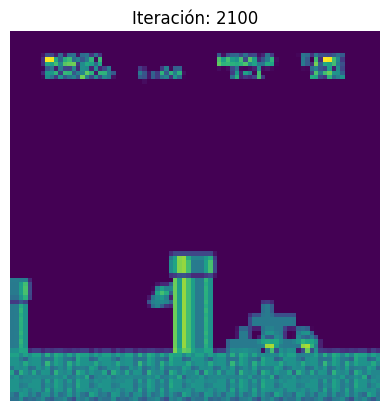

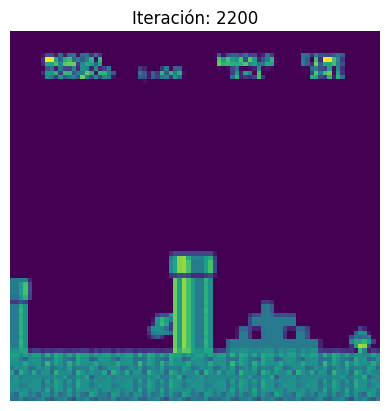

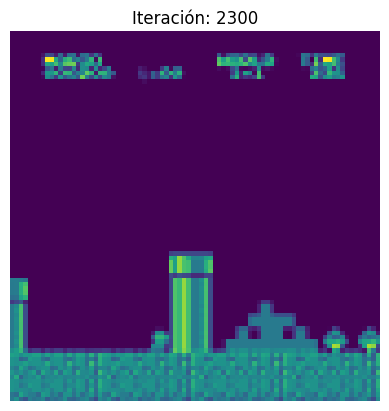

Iteration: 2400, Loss: 0.5033599734306335
Tiempo transcurrido para 300 iteraciones: 709.55 segundos


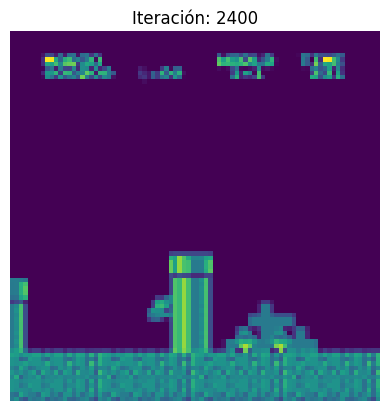

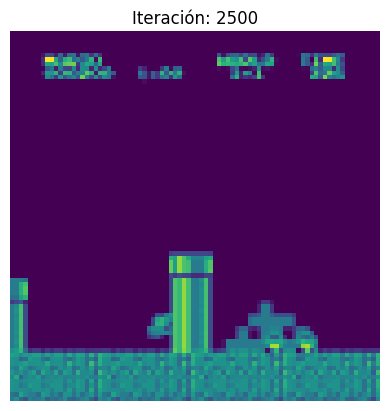

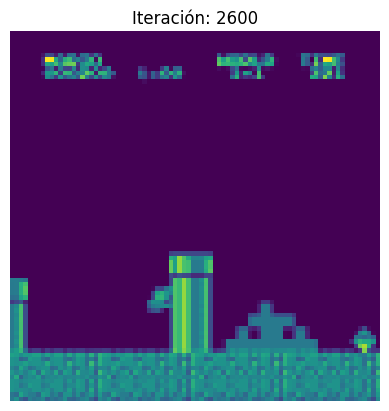

Iteration: 2700, Loss: 0.05331741273403168
Tiempo transcurrido para 300 iteraciones: 798.50 segundos


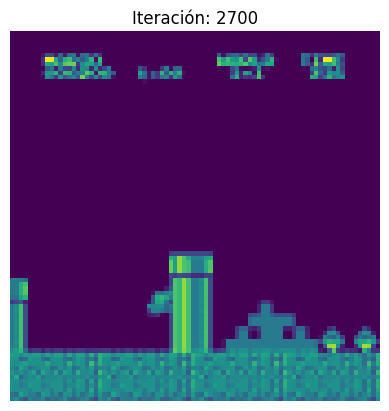

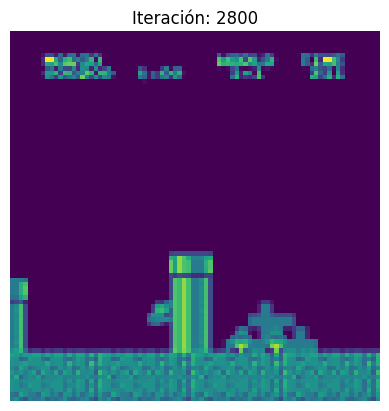

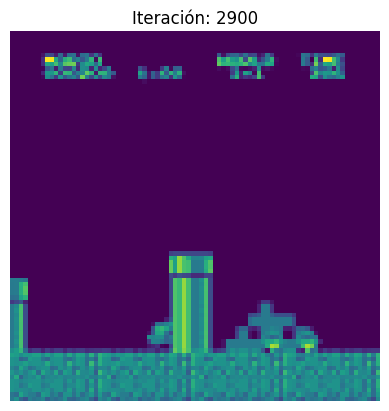

Iteration: 3000, Loss: 0.0921715497970581
Tiempo transcurrido para 300 iteraciones: 890.38 segundos


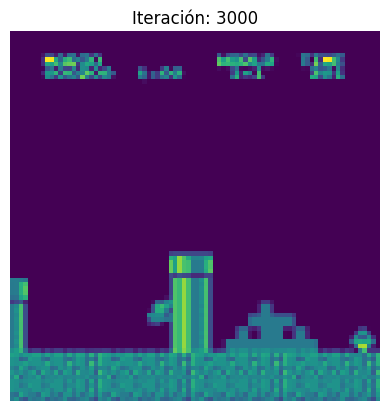

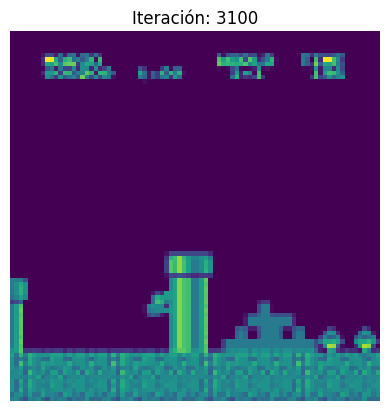

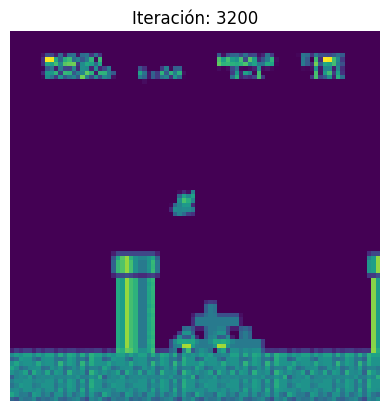

Iteration: 3300, Loss: 0.19046762585639954
Tiempo transcurrido para 300 iteraciones: 974.14 segundos


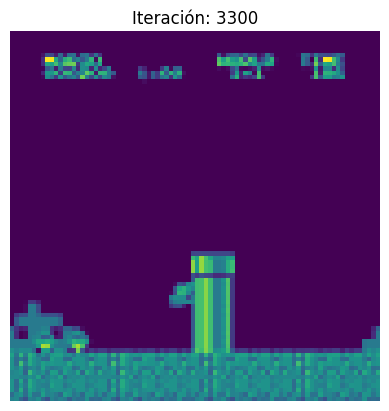

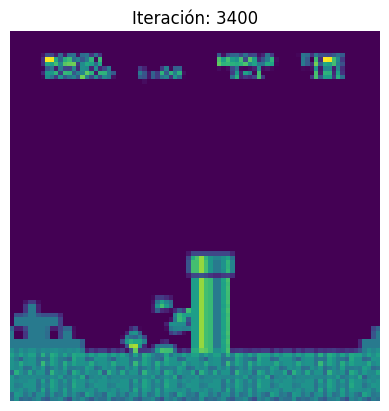

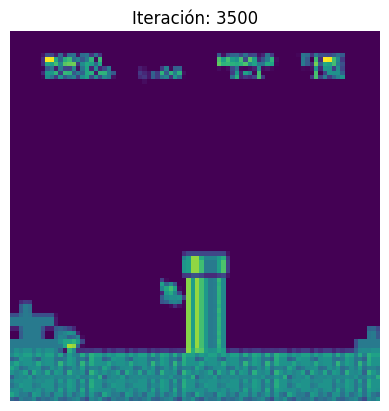

Iteration: 3600, Loss: 0.1315663456916809
Tiempo transcurrido para 300 iteraciones: 1065.30 segundos


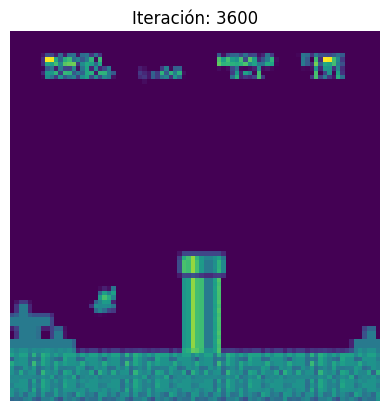

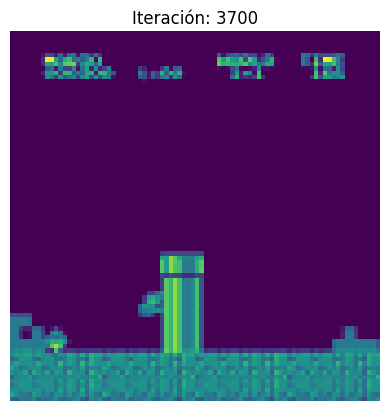

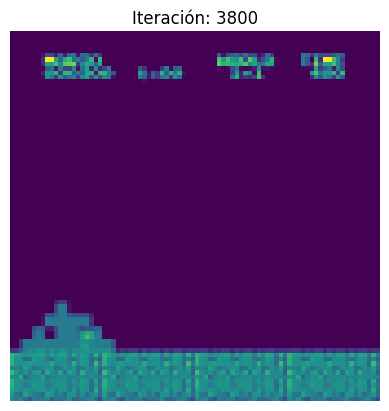

Iteration: 3900, Loss: 0.09737451374530792
Tiempo transcurrido para 300 iteraciones: 1157.82 segundos


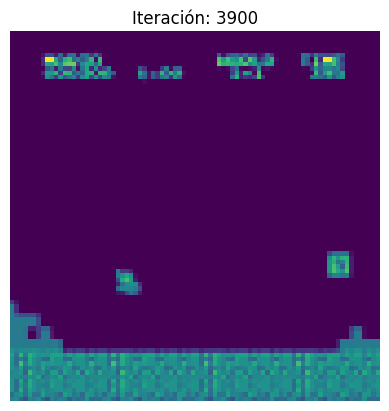

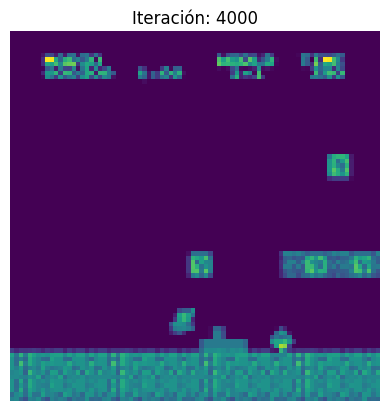

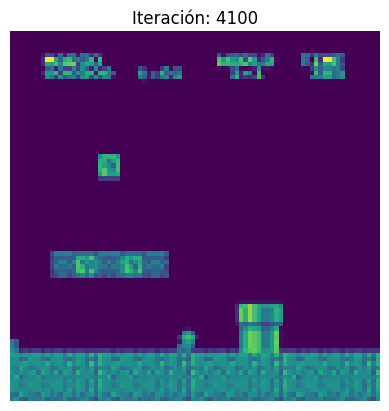

Iteration: 4200, Loss: 0.23441585898399353
Tiempo transcurrido para 300 iteraciones: 1249.91 segundos


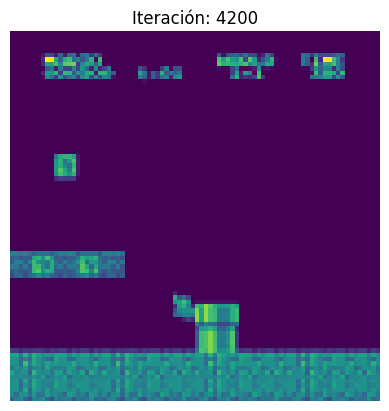

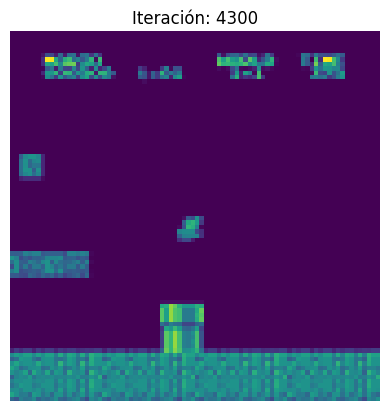

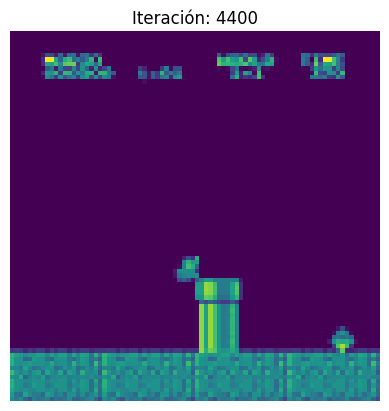

Iteration: 4500, Loss: 0.05347536504268646
Tiempo transcurrido para 300 iteraciones: 1338.17 segundos


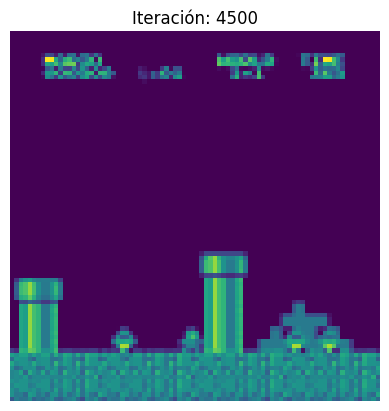

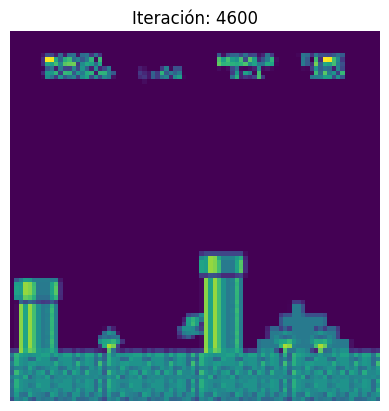

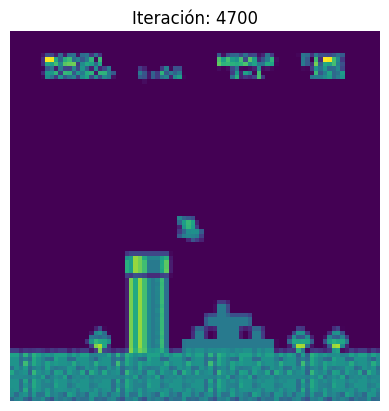

Iteration: 4800, Loss: 0.23882851004600525
Tiempo transcurrido para 300 iteraciones: 1426.00 segundos


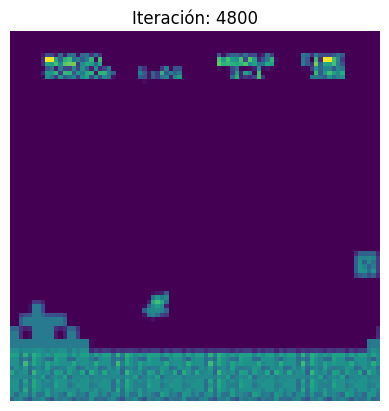

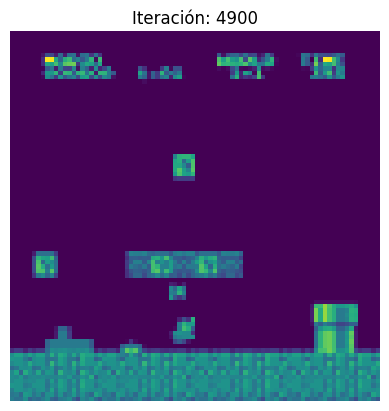

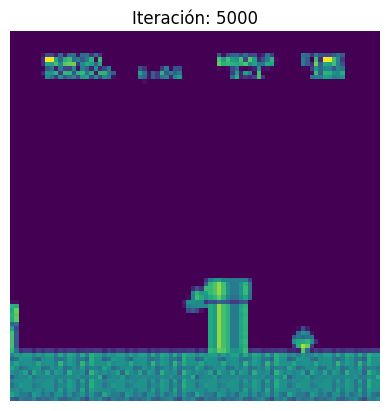

Iteration: 5100, Loss: 0.43288764357566833
Tiempo transcurrido para 300 iteraciones: 1514.52 segundos


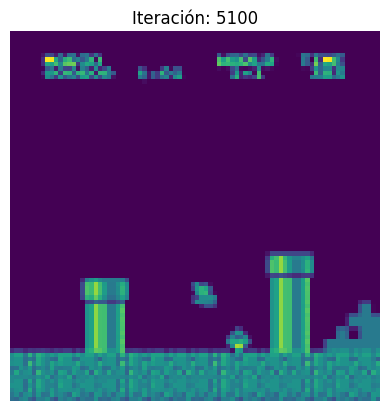

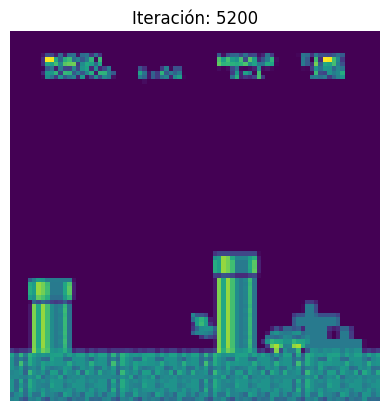

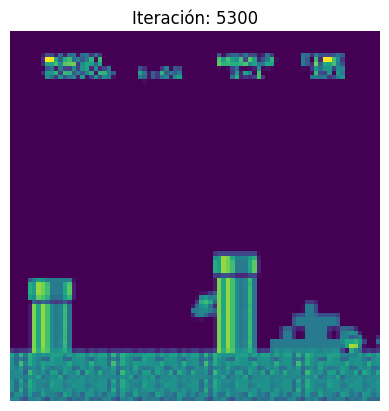

Iteration: 5400, Loss: 0.11663765460252762
Tiempo transcurrido para 300 iteraciones: 1605.23 segundos


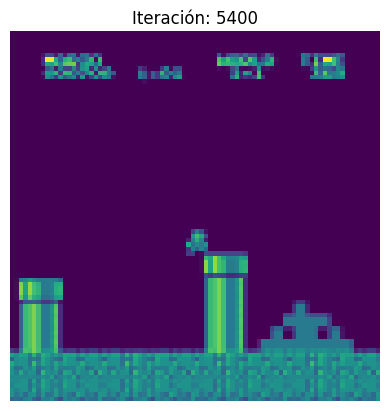

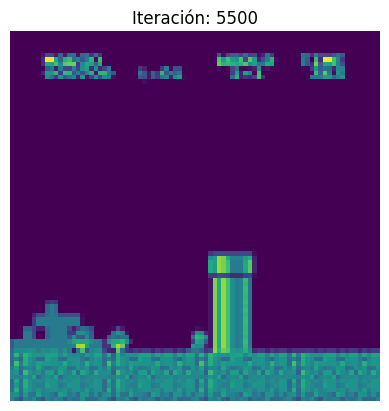

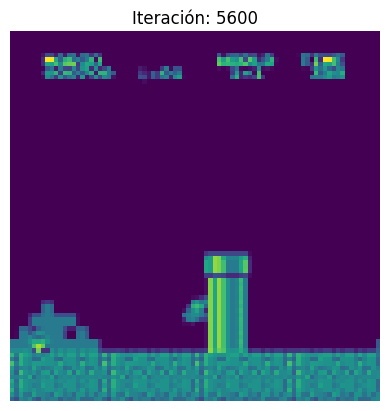

Iteration: 5700, Loss: 0.420718252658844
Tiempo transcurrido para 300 iteraciones: 1693.21 segundos


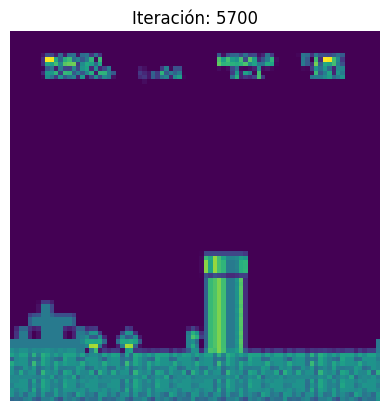

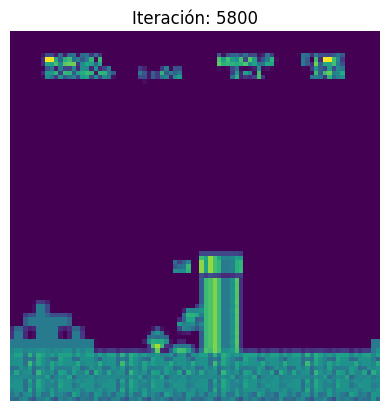

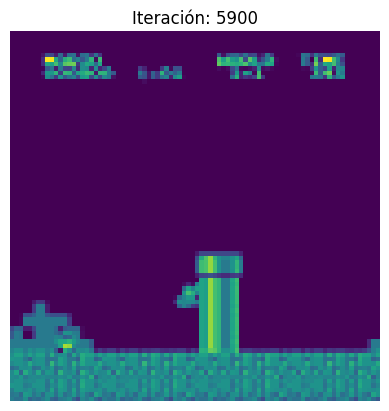

Iteration: 6000, Loss: 0.2957441210746765
Tiempo transcurrido para 300 iteraciones: 1783.88 segundos


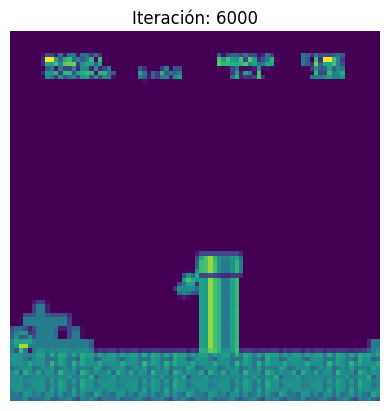

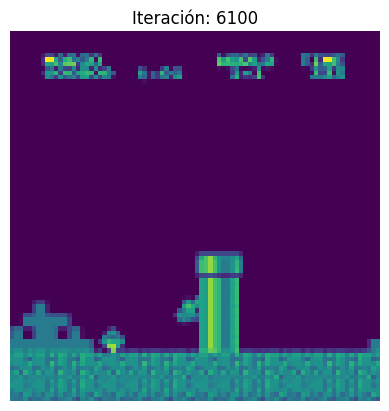

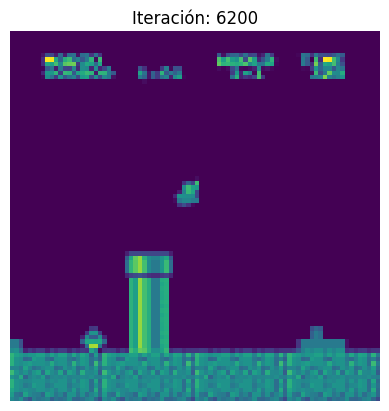

Iteration: 6300, Loss: 0.21656620502471924
Tiempo transcurrido para 300 iteraciones: 1874.34 segundos


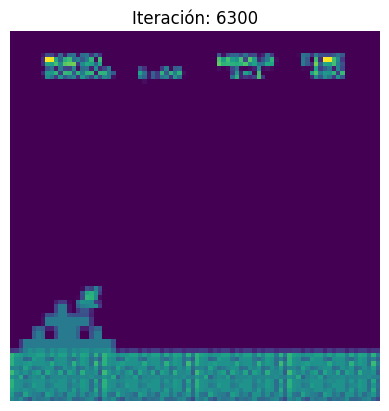

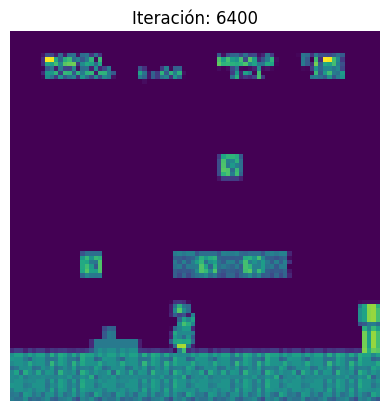

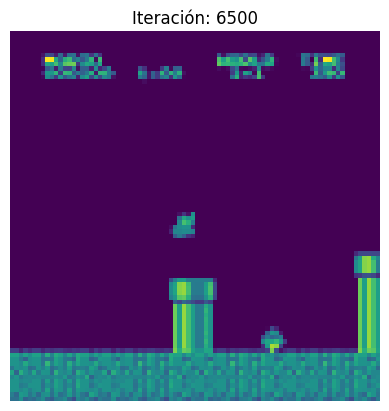

Iteration: 6600, Loss: 0.5232350826263428
Tiempo transcurrido para 300 iteraciones: 1965.39 segundos


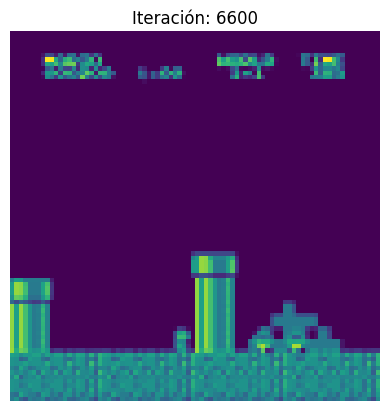

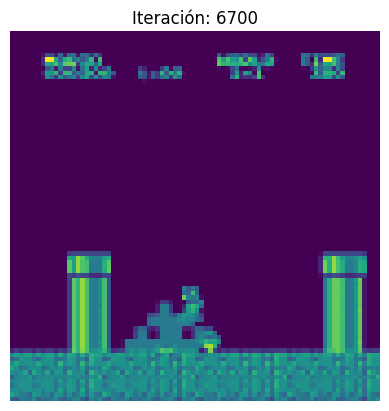

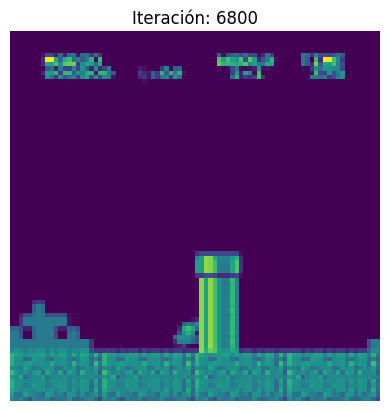

Iteration: 6900, Loss: 0.1281142383813858
Tiempo transcurrido para 300 iteraciones: 2055.82 segundos


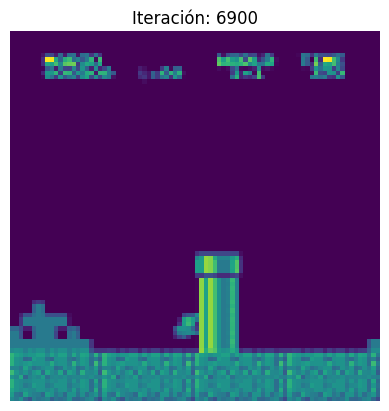

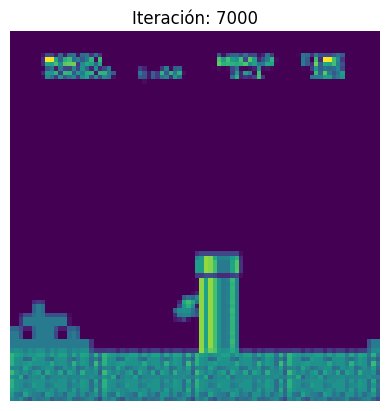

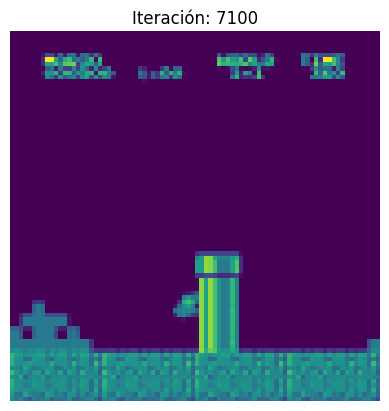

Iteration: 7200, Loss: 0.10992743074893951
Tiempo transcurrido para 300 iteraciones: 2147.31 segundos


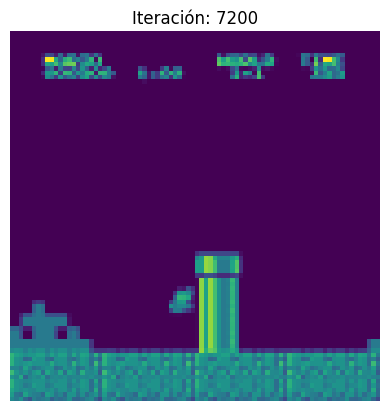

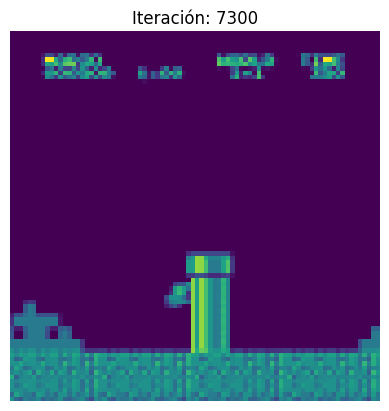

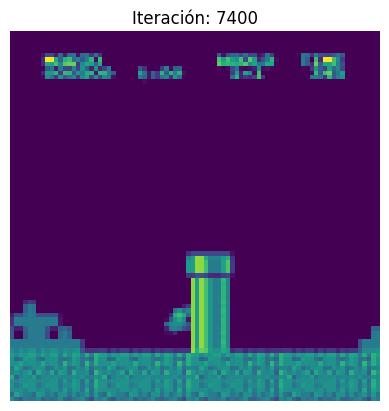

Iteration: 7500, Loss: 0.19623564183712006
Tiempo transcurrido para 300 iteraciones: 2236.45 segundos


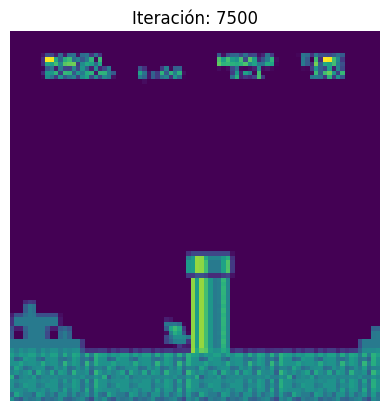

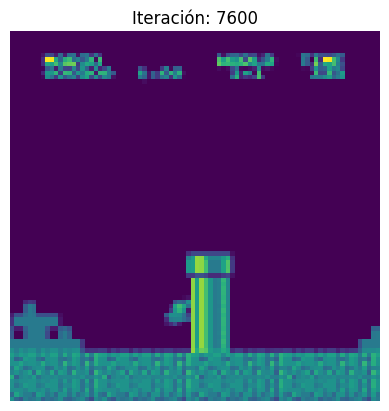

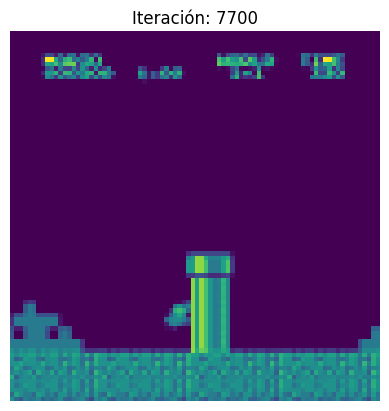

Iteration: 7800, Loss: 0.24529671669006348
Tiempo transcurrido para 300 iteraciones: 2327.44 segundos


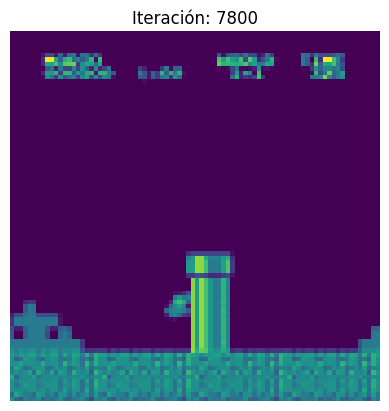

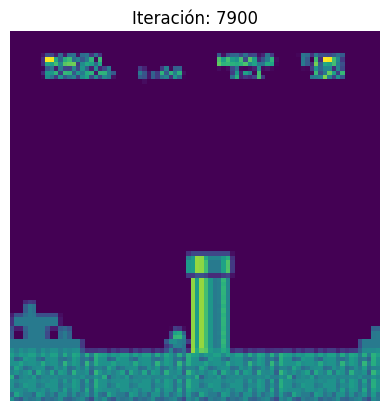

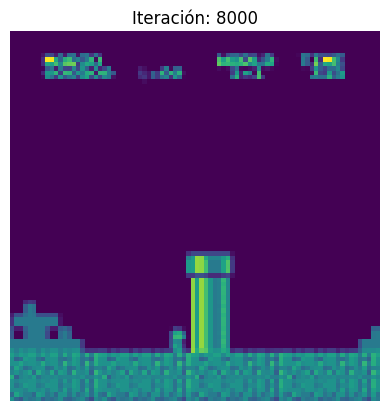

Iteration: 8100, Loss: 0.20237527787685394
Tiempo transcurrido para 300 iteraciones: 2416.81 segundos


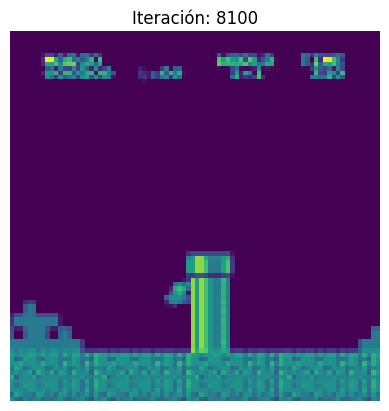

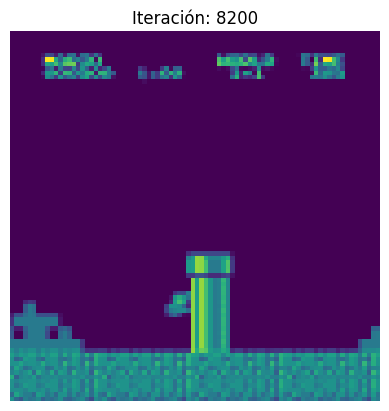

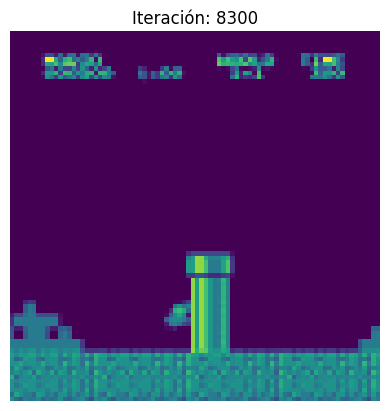

Iteration: 8400, Loss: 0.069029301404953
Tiempo transcurrido para 300 iteraciones: 2508.15 segundos


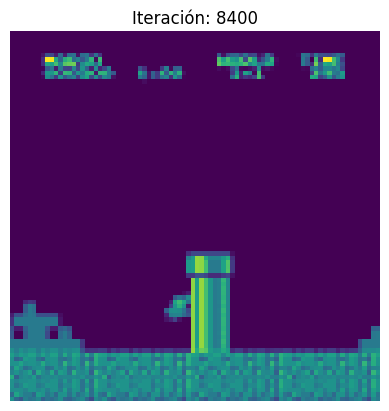

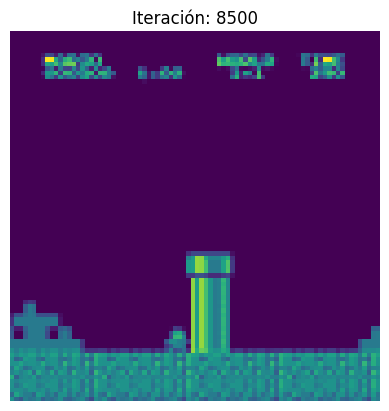

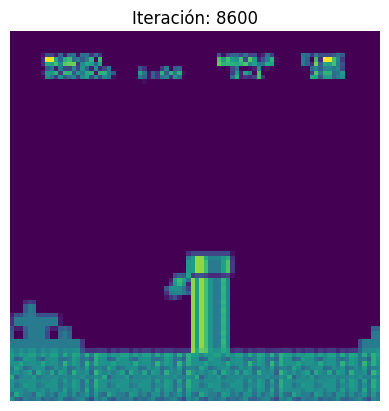

Iteration: 8700, Loss: 0.21616610884666443
Tiempo transcurrido para 300 iteraciones: 2598.69 segundos


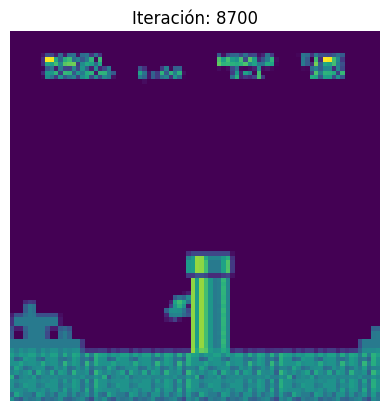

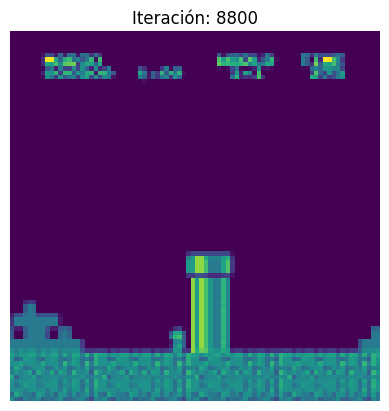

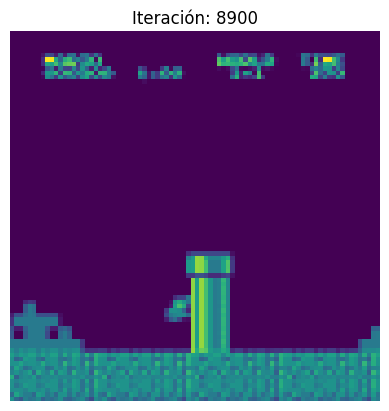

Iteration: 9000, Loss: 0.09344199299812317
Tiempo transcurrido para 300 iteraciones: 2689.99 segundos


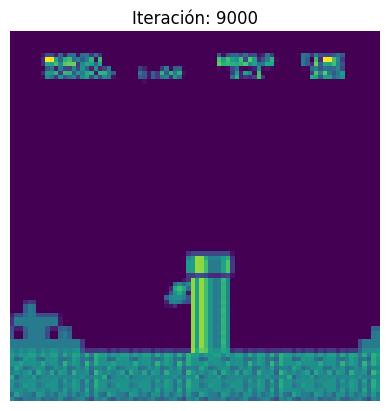

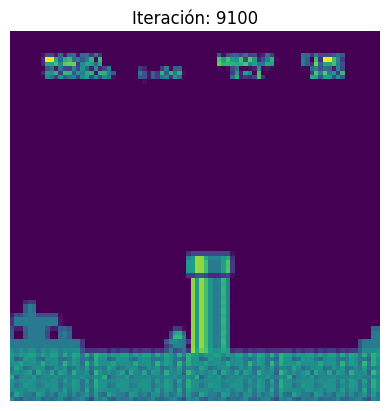

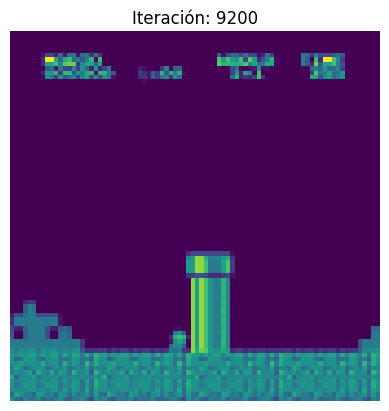

Iteration: 9300, Loss: 0.25865456461906433
Tiempo transcurrido para 300 iteraciones: 2778.65 segundos


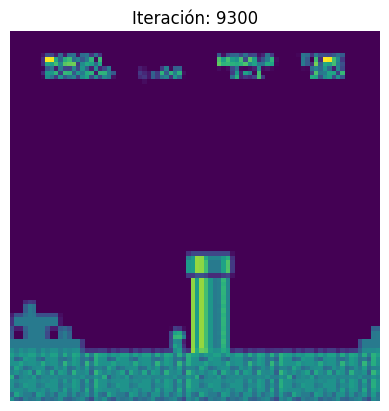

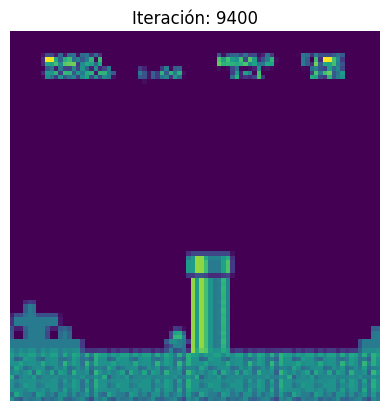

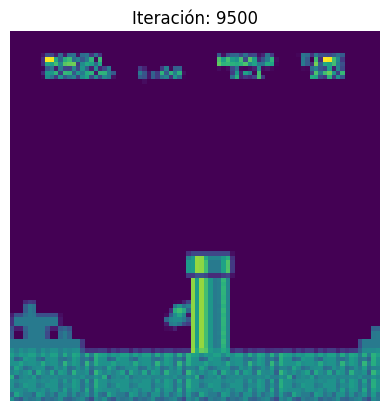

Iteration: 9600, Loss: 0.13665428757667542
Tiempo transcurrido para 300 iteraciones: 2868.70 segundos


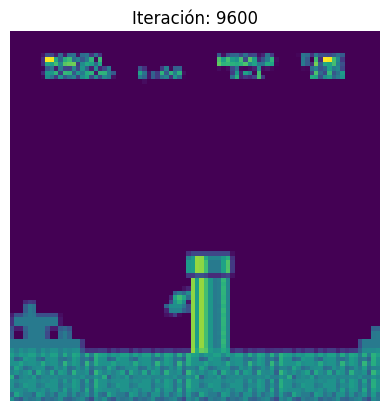

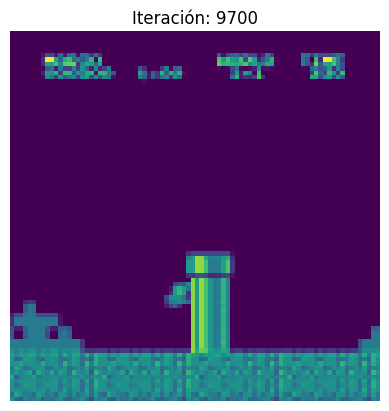

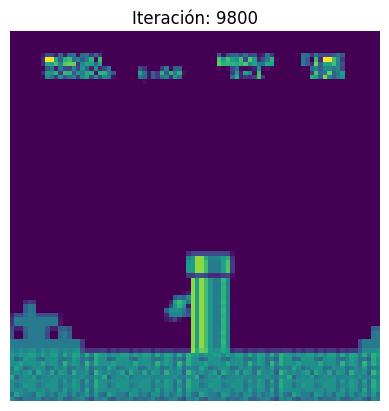

Iteration: 9900, Loss: 0.10277333855628967
Tiempo transcurrido para 300 iteraciones: 2959.03 segundos


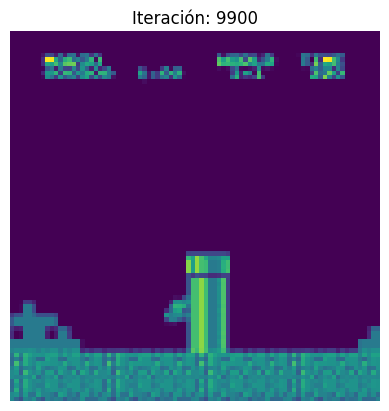

In [ ]:
# Training the agent
num_iterations = 10000  # Adjust this value based on Kaggle's computational limits
collect_steps_per_iteration = 1
log_interval = 300
start_time = time.time()  # Registra el tiempo de inicio
for iteration in range(num_iterations):
    # Collect experience
    for _ in range(collect_steps_per_iteration):
        collect_step(train_env, agent.collect_policy, replay_buffer)
    # Sample a batch of data and train the agent
    experience, _ = next(iterator)
    train_loss = agent.train(experience).loss
    # Capturar el estado del entorno (evaluated_image) después de recolectar experiencia
    # Esto puede variar según cómo esté implementado tu entorno y agente

    if iteration % log_interval == 0:
        print(f'Iteration: {iteration}, Loss: {train_loss}')
        end_time = time.time()  # Registra el tiempo de finalización
        elapsed_time = end_time - start_time  # Calcula el tiempo transcurrido
        print(f'Tiempo transcurrido para 300 iteraciones: {elapsed_time:.2f} segundos')
    if iteration % 100 == 0:
        alex = train_env.current_time_step()  # Obtener el estado actual del entorno

        # Obtener la imagen de la experiencia
        evaluated_image = alex.observation

        # Reducir dimensiones y seleccionar el primer frame del stack
        evaluated_image = evaluated_image[0, 0]  # Acceder al primer batch y al primer frame
        evaluated_image = np.squeeze(evaluated_image)  # Eliminar dimensiones innecesarias

        # Mostrar la imagen evaluada
        plt.imshow(evaluated_image)  # Usar cmap='gray' si es escala de grises
        plt.axis('off')  # Opcional: quitar los ejes
        plt.title(f'Iteración: {iteration}')  # Título opcional
        plt.show()  # Mostrar la imagen




Episode 1: Ite.: 500 :episode_reward : 1053.0


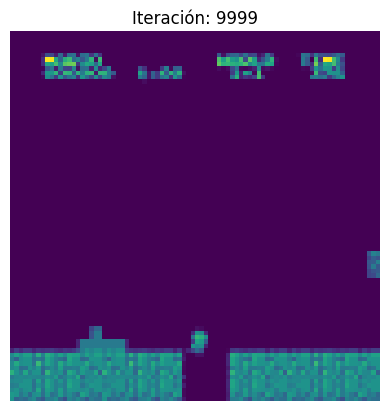

Episode 2: Ite.: 500 :episode_reward : 1053.0


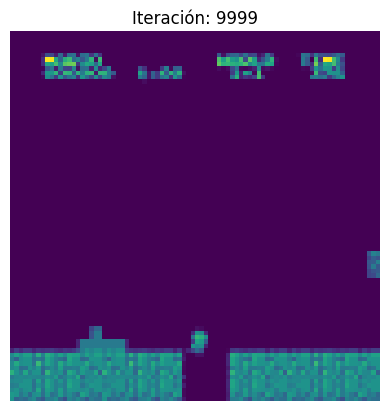

Episode 3: Ite.: 500 :episode_reward : 1053.0


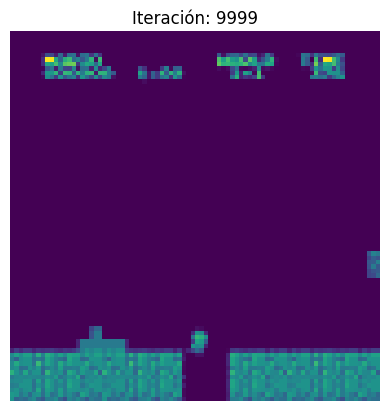

Episode 4: Ite.: 500 :episode_reward : 1053.0


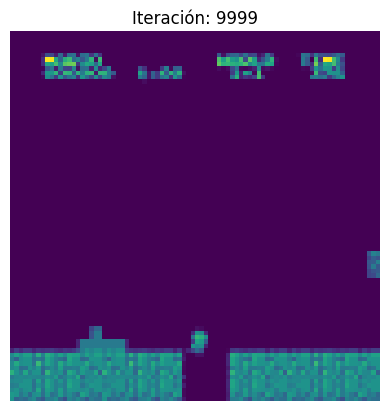

Episode 5: Ite.: 500 :episode_reward : 1053.0


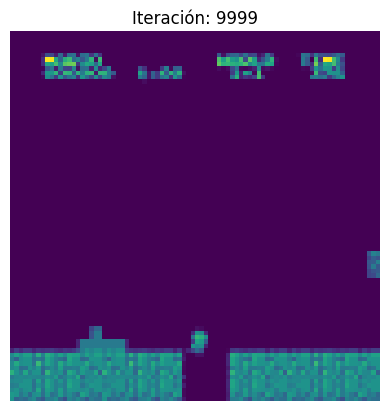

In [ ]:
# Evaluate the agent's performance
log_interval = 500
num_eval_episodes = 5
for episode in range(num_eval_episodes):
    time_step = eval_env.reset()
    episode_reward = 0
    i = 0
    while not time_step.is_last():
        action_step = agent.policy.action(time_step)
        time_step = eval_env.step(action_step.action)
        episode_reward += time_step.reward
        i+=1

        if i % log_interval == 0:
            print(f'Episode {episode + 1}: Ite.: {i} :episode_reward : {episode_reward.numpy()[0]}')
        if i % 500 == 0:
            alex = eval_env.current_time_step()  # Obtener el estado actual del entorno

            # Obtener la imagen de la experiencia
            evaluated_image = alex.observation

            # Reducir dimensiones y seleccionar el primer frame del stack
            evaluated_image = evaluated_image[0, 0]  # Acceder al primer batch y al primer frame
            evaluated_image = np.squeeze(evaluated_image)  # Eliminar dimensiones innecesarias

            # Mostrar la imagen evaluada
            plt.imshow(evaluated_image)  # Usar cmap='gray' si es escala de grises
            plt.axis('off')  # Opcional: quitar los ejes
            plt.title(f'Iteración: {iteration}')  # Título opcional
            plt.show()  # Mostrar la imagen
    #print(f'Episode {episode + 1}: Reward = {episode_reward.numpy()[0]}')

In [ ]:


# Set up a virtual display for rendering OpenAI gym environments.
display = pyvirtualdisplay.Display(visible=0, size=(1400, 900)).start()


# Visualization functions provided
def update_scene(num, frames, patch):
    patch.set_data(frames[num])
    return patch

def plot_animation(frames, repeat=False, interval=100):
    fig = plt.figure(facecolor='white')  # Cambiar a fondo blanco
    patch = plt.imshow(frames[0])  # Mostrar el primer frame
    plt.axis('off')
    anim = animation.FuncAnimation(
        fig, update_scene, fargs=(frames, patch),
        frames=len(frames), repeat=repeat, interval=interval
    )
    plt.close()
    return anim

# Collect frames for visualization
def run_and_visualize(agent, env):
    frames = []
    time_step = env.reset()
    policy_state = agent.policy.get_initial_state(env.batch_size)
    while not time_step.is_last():

        action_step = agent.policy.action(time_step, policy_state)
        policy_state = action_step.state
        time_step = env.step(action_step.action)
        frame = np.squeeze(env.render())
        frames.append(frame)

    print(f"Total frames collected: {len(frames)}")  # Debugging line
    return frames

# Run the agent and collect frames
frames = run_and_visualize(agent, eval_env)



# Create and display the animation
anim = plot_animation(frames)



from IPython.display import HTML
HTML(anim.to_jshtml())



Total frames collected: 763


In [ ]:
print(f"Total frames collected: {len(frames)}")
if frames:
    print(frames[0].shape)  # Imprime la forma del primer frame

Total frames collected: 763
(240, 256, 3)
